# Problem Statement

# Training Dataset

Houses are one of the necessary need of each and every person around the globe. It is a very large market and there are various companies working in the domain. Data science comes as a very important tool to solve problems in the domain to help the companies increase their overall revenue and profits.

A US-based housing company named Surprise Housing has decided to enter the Australian market. The company is looking at prospective properties to buy houses to enter the market. The company uses data analytics to purchase houses at a price below their actual values and flip them at a higher price.

The purpose is to build a model using Machine Learning in order to predict the actual value of the prospective properties and decide whether to invest in them or not. The requirement is to to model the price of houses with the available independent variables in the test data.

The data is divided into two i.e. train and test data set. Model building will be done with the help of train data set and the same would be used on the test data set to predict house prices. The company has collected a data set from the sale of houses in Australia and is provided in the CSV file.

In [1]:
#importing the libraries

import pandas as pd
import numpy as np
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
import csv

In [2]:
#importing the dataset

df = pd.read_csv(r'C:\Users\HP-15\housing_train.csv')

In [3]:
df

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000
5,1197,60,RL,58.0,14054,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,11,2006,New,Partial,219210
6,561,20,RL,NaN,11341,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2010,WD,Normal,121500
7,1041,20,RL,88.0,13125,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,GdPrv,NaN,0,1,2006,WD,Normal,155000
8,503,20,RL,70.0,9170,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,GdPrv,Shed,400,4,2007,WD,Normal,140000
9,576,50,RL,80.0,8480,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,10,2008,COD,Abnorml,118500


The dataset consists of 1168 records and 81 attributes in the dataset initially.

The "Id" column in the above dataset does not have any relationship with the dependent/target variable as ID will have a unique identity for each record. Hence, we drop the column.



In [4]:
df.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [5]:
#Dropping "Id" column from the dataset because it has no relation with target varaible
df.drop("Id",axis=1 , inplace=True)

In [6]:
#Checking if the Id column is dropped by visualizing gist of data

df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,...,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,...,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,...,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,...,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,...,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


It is clearly noticable that the "Id" column has been removed from the above data set. Since the data set is huge, the whole data cannot be seen, hence maximum data needs to be visualized to understand data

In [7]:
#Displaying maximum columns for better understaning of data

pd.set_option('display.max_columns',None)
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000


We can now see all the columns being displayed in the dataframe.

In [8]:
#Checking size of present dataset
df.shape

(1168, 80)

In [9]:
#Displaying maximum rows to visualize data type of all attributes
pd.set_option('display.max_rows',None)

The dataset now consits of 1168 rows and 80 columns.

In [10]:
#Checking data types of the attributes
df.dtypes

MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
Utilities         object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object
HeatingQC         object


It is very important to check the null values present in the data to clean data before proceeding. We cannot analyse data without removing null values in data.

# Checking Null Values

In [11]:
df.isnull().sum()

MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFinSF        0
GrLivArea 

Since the null(NaN) values present in columns "PoolQC", "Fence", "MiscFeature" & "Alley" are more than 70% of the records in the data set. So the variables does not seem to be of any importance in analysing the sale price, hence removing them from the data set.

The other null values present will be treated using SimpleImputer and Imputer techniques. Null values in data set needs to be treated in order to make an analysis on data.

In [12]:
#Dropping variables with maximum null values i.e. near to 70% of data are null values
df.drop("PoolQC",axis=1,inplace=True)
df.drop("Fence",axis=1,inplace=True)
df.drop("MiscFeature",axis=1,inplace=True)
df.drop("Alley",axis=1,inplace=True)

In [13]:
#Checking number of variables left in the dataset
df.shape

(1168, 76)

It is noticable that 4 variables have been dropped from the data set.

Now will treat null values in the data set.

In [14]:
#Filling Nan values using 'most_frequent' of simle Imputer for categorical data
from sklearn.impute import SimpleImputer

imp=SimpleImputer(strategy='most_frequent')

df['GarageQual']=imp.fit_transform(df['GarageQual'].values.reshape(-1,1))
df['GarageCond']=imp.fit_transform(df['GarageCond'].values.reshape(-1,1))
df['GarageFinish']=imp.fit_transform(df['GarageFinish'].values.reshape(-1,1))
df['GarageType']=imp.fit_transform(df['GarageType'].values.reshape(-1,1))
df['FireplaceQu']=imp.fit_transform(df['FireplaceQu'].values.reshape(-1,1))
df['BsmtFinType2']=imp.fit_transform(df['BsmtFinType2'].values.reshape(-1,1))
df['BsmtFinType1']=imp.fit_transform(df['BsmtFinType1'].values.reshape(-1,1))
df['BsmtExposure']=imp.fit_transform(df['BsmtExposure'].values.reshape(-1,1))
df['BsmtCond']=imp.fit_transform(df['BsmtCond'].values.reshape(-1,1))
df['BsmtQual']=imp.fit_transform(df['BsmtQual'].values.reshape(-1,1))
df['MasVnrType']=imp.fit_transform(df['MasVnrType'].values.reshape(-1,1))

df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,RL,NaN,4928,Pave,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,0,2,2007,WD,Normal,128000
1,20,RL,95.0,15865,Pave,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,0,10,2007,WD,Normal,268000
2,60,RL,92.0,9920,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,0,6,2007,WD,Normal,269790
3,20,RL,105.0,11751,Pave,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,0,1,2010,COD,Normal,190000
4,20,RL,NaN,16635,Pave,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,0,6,2009,WD,Normal,215000


We used "most_frequent" strategy of Simple Imputer to fill null values of categorical data.

In [15]:
#Checking Null values
df.isnull().sum()

MSSubClass         0
MSZoning           0
LotFrontage      214
LotArea            0
Street             0
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         0
MasVnrArea         7
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           0
BsmtCond           0
BsmtExposure       0
BsmtFinType1       0
BsmtFinSF1         0
BsmtFinType2       0
BsmtFinSF2         0
BsmtUnfSF          0
TotalBsmtSF        0
Heating            0
HeatingQC          0
CentralAir         0
Electrical         0
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath       0
BsmtHalfBath       0
FullBath     

The NaN values of categorical data is filled. Now we will deal with the Null values in numeric data. To deal with numeric data, we fill the values using median.

In [16]:
#Importing Libraries to treat Null values using median
from sklearn.impute import SimpleImputer
import warnings
warnings.filterwarnings('ignore')
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

In [17]:
#treating null values using Imputer
for i in df.columns:
    if df[i].isnull().sum()!=0:
        df[i]=imp.fit_transform(df[i].values.reshape(-1,1))

In [18]:
#Checking null values again
df.isnull().sum()

MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd

We now observe that our null values have been treated. Let's visualize and check if we still have any Null Values.

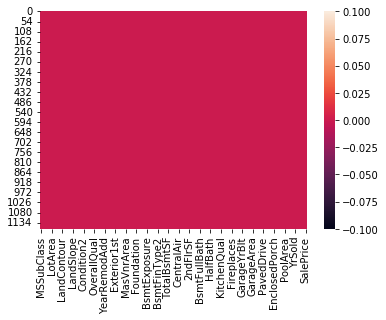

In [19]:
#Visualizing null values through heatmap
import seaborn as sns
sns.heatmap(df.isnull())

We cannot see any Null Values in our dataset. Hence, we can proceed forward with visualizing our data.

# Making DataFrame for the Nominal Data

In [20]:
#Copying nominal variables into a new dataframe
df_nominal=df[['MSZoning','Street','LotShape', 'LandContour', 'Utilities', 'LotConfig','LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType','HouseStyle','RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType','ExterQual', 'ExterCond', 'Foundation', 'BsmtQual','BsmtCond', 'BsmtExposure', 'BsmtFinType1','BsmtFinType2', 'Heating','HeatingQC', 'CentralAir', 'Electrical','KitchenQual','Functional','FireplaceQu','GarageType','GarageFinish','GarageQual','GarageCond','PavedDrive','SaleType','SaleCondition']].copy()

We create a new separate dataframe to store all categorical data and make an analysis on it separetly.

In [21]:
#Checking columns of new nominal dataframe created
df_nominal.columns

Index(['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition'],
      dtype='object')

In [22]:
#Cheking shape of new nominal dataframe
df_nominal.shape

(1168, 39)

We have 1168 rows and 39 columns in the nominal DataFrame.

# Visualization of Data

For the nominal/categorical data we will use countplot as it will gives frequency of the columns.

In [23]:
#Importing Libraries for Visualization
import seaborn as sns
import matplotlib.pyplot as plt

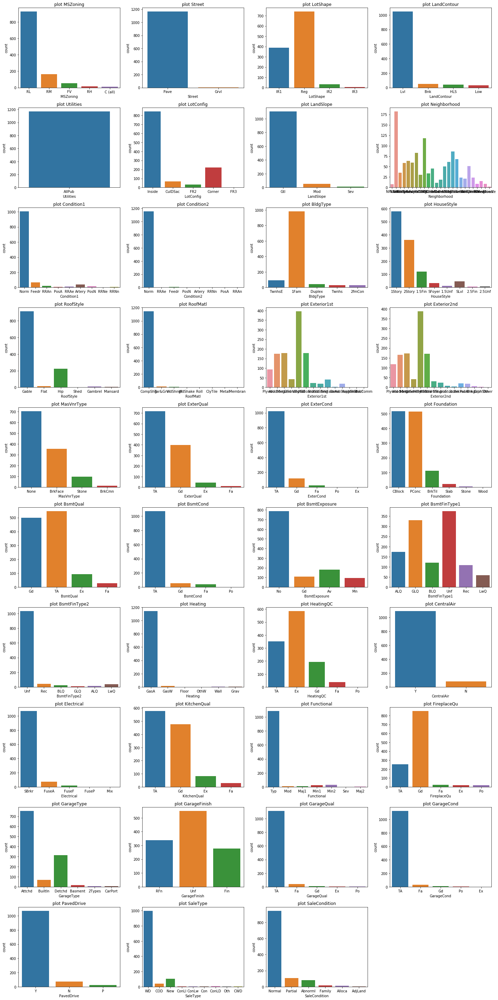

In [24]:
#Visualizing different columns using countplot
ncol,nrow=10,4
ab=df_nominal.columns.values
plt.figure(figsize=(20,40))
for index,i in enumerate(ab):
    ab=plt.subplot(ncol,nrow,index+1)
    sns.countplot(df[i])
    plt.title(f"plot {i}")
    plt.tight_layout()
plt.show()

# Observation:

All the records in the data set consists of the "All public Utilities (E,G,W,& S)" in the 'Utilities' variable. Since the data in 'Utilities' column does not make any difference to the data set, we delete the column.

In MSZoning (general zoning classification of the sale) variable, maximum values belong to the "Residential Low Density" category, then from "Residential Medium Density" and least from "C(all)" category.

Type of road access to property ('Street') is "Paved" for most of the records.

General shape of property ('LotShape') is "Regular" for most of the cases, second most is "Slightly irregular" and hardly some properties have "Irregular" property shape.

Flatness of the property ('LandContour') is mostly "Near Flat/Level" for maximum records and least records have "Depression" flatness.

Lot configuration ('LotConfig') belongs to "Inside lot" for most of the properties in the data set, second most belongs to "Corner lot" and least belongs to "Frontage on 3 sides of property" category.

Maximum records have "Gentle slope" and very few have "Severe Slope" for variable Slope of property ('LandSlope').

Proximity to various conditions ('Condition1') are "Normal" in most of the cases and least are "Within 200' of East-West Railroad".

Proximity to various conditions ('Condition2') is 'Normal' for around 1500 records. Hardly the property has other various conditions.

'BldgType' is "1Fam" i.e. "Single-family Detached" for nearly 1000 records.

Style of dwelling ('HouseStyle') is "One story" which is maximum for nearly 580 records, "Two story" for nearly 360 records, "One and one-half story" for around 110 properties.

Type of roof ('RoofStyle') is "Gable" for more than 900 values and around 200 values for "Hip".

Roof material is "Standard (Composite) Shingle" for more than 110 properties in the dataset.

The value for 'Masonry veneer type' is "None" for 700 records, "Brick Face" for nearly 350 records, "Stone" for nearly 100 records and least for "Brick Common".

Quality of the material on the exterior ('ExterQual') is "Average/Typical" for more than 700 properties, "Good" for nearly 400 properties and least are "Excellent".

Present condition of the material ('ExterCond') on the exterior is "Average/Typical" is for more than 1000 properties.

Type of foundation ('Foundation') is maximum around 500 values for both "Cinder Block" & "Poured Contrete" and least for "Wood".

Height of the basement ('BsmtQual') is "Typical (80-89 inches)" and "Good (90-99 inches)" for most of the records in data set.

General condition of the basement ('BsmtCond') is "Average/Typical" for more tha 1000 properties and very few properties have "Poor" material.

'BsmtExposure' (Refers to walkout or garden level walls) has "No Exposure" for nearly 800 properties.

'BsmtFinType1' (Rating of basement finished area) is maximum for "Unfinished" i.e 350 values, second max for "Good Living Quarters" and least have "Low Quality".

'BsmtFinType2' (Rating of basement finished area) is maximum for "Unfinished" i.e more than 1000 records.

Type of heating ('Heating') has maximum values for "GasA - Gas forced warm air furnace" category which is more than 1100 records.

Central air conditioning ('CentralAir') is available ("Yes") for around 1100 properties.

'Electrical' is "Standard Circuit Breakers & Romex" for more than 1000 properties.

Kitchen quality ('KitchenQual') is "Typical/Average" & "Good" for most records in the data set.

Home functionality ('Functional') is "Typical Functionality" for more than 1000 properties.

Fireplace quality ('FireplaceQu') is "Good " for more than 800 properties and "Average" for around 250 properties which includes the maximum records.

'GarageType' is "Attchd" for maximum records and second maximum records holds for "Detchd".

'GarageFinish' holds maximum records for "Unfinished", second max for "Rough Finished" and least for "Finished" which below 300 properties.

'GarageQual' is "Typical/Average" for around 1100 properties and very less for the rest.

'GarageCond' is also "Typical/Average" for around 1100 properties and very less for the rest.

Paved driveway ('PavedDrive') is "Paved" for more than 1000 records.

'SaleType' is "Warranty Deed - Conventional" for around 1000 properties.

'SaleCondition' is "Normal Sale" for nearly 950 records.

In [25]:
#dropping column having no importance data since all the values inside the column are same
df.drop("Utilities",axis=1,inplace=True)

NAmes      182
CollgCr    118
OldTown     86
Edwards     83
Somerst     68
Gilbert     64
NridgHt     61
Sawyer      60
NWAmes      59
SawyerW     51
BrkSide     50
Crawfor     45
NoRidge     35
Mitchel     34
IDOTRR      30
Timber      24
ClearCr     24
SWISU       21
StoneBr     19
Blmngtn     15
BrDale      11
MeadowV      9
Veenker      9
NPkVill      8
Blueste      2
Name: Neighborhood, dtype: int64


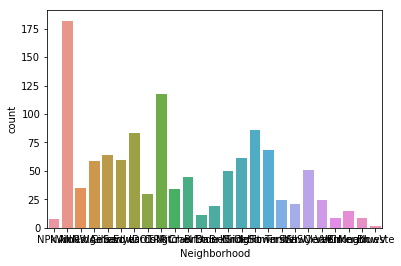

In [26]:
#Visualizing data which was not clear in the above analysis
ab=sns.countplot(x='Neighborhood', data=df_nominal)
print(df_nominal['Neighborhood'].value_counts())

'Neighborhood' of the maximum properties are "NAmes: North Ames" and "College Creek".

VinylSd    396
HdBoard    179
MetalSd    178
Wd Sdng    174
Plywood     93
CemntBd     42
BrkFace     41
Stucco      22
AsbShng     19
WdShing     19
Stone        2
BrkComm      1
ImStucc      1
AsphShn      1
Name: Exterior1st, dtype: int64


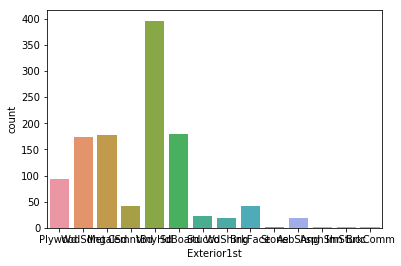

In [27]:
ab=sns.countplot(x='Exterior1st', data=df_nominal)
print(df_nominal['Exterior1st'].value_counts())

Exterior covering on house i.e. 'Exterior1st' are maximum for "Vinyl Siding" (maximum records), "Hard Board", "Metal Siding" and "Wood Siding"

VinylSd    387
MetalSd    173
HdBoard    170
Wd Sdng    165
Plywood    118
CmentBd     42
Wd Shng     31
Stucco      23
BrkFace     20
AsbShng     18
ImStucc      8
Brk Cmn      5
Stone        4
AsphShn      3
Other        1
Name: Exterior2nd, dtype: int64


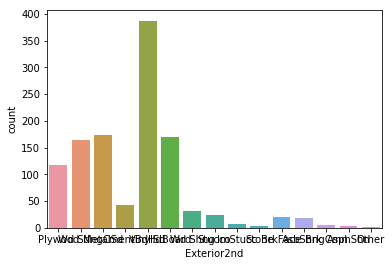

In [28]:
ab=sns.countplot(x='Exterior2nd', data=df_nominal)
print(df_nominal['Exterior2nd'].value_counts())

'Exterior2nd' has maximum records for "Vinyl Siding".

# Making DataFrame of the Continuous type of Values

In [29]:
#Copying our continuous data into a new dataframe
df_continuous=df[['MSSubClass','LotFrontage','LotArea','OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF','1stFlrSF', '2ndFlrSF', 'LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars', 'GarageArea','WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch','ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold','SalePrice']].copy()

Created a new separate dataframe to store all numeric data and make an analysis on it separetly.

In [30]:
#Verifying columns
df_continuous.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces',
       'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal',
       'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [31]:
#Cheking shape of new numeric dataframe
df_continuous.shape

(1168, 37)

# Visualizing Continuous Data

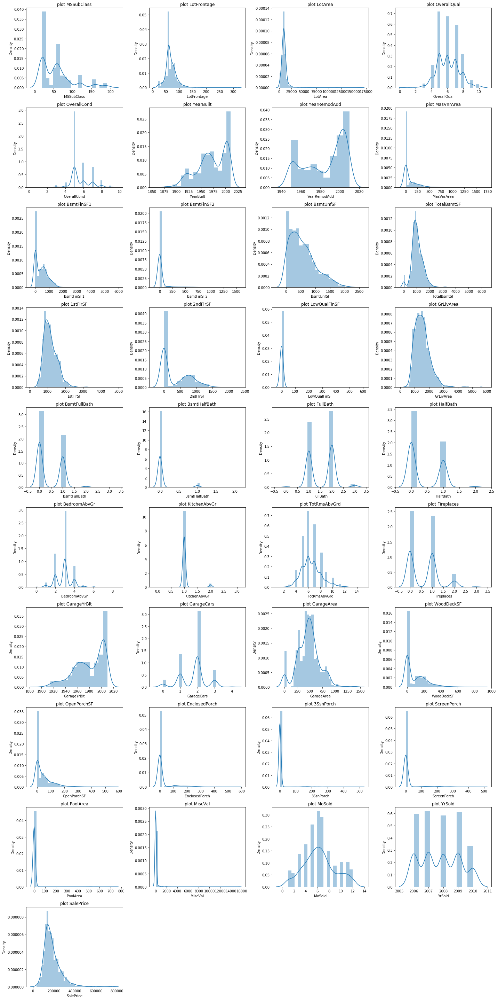

In [32]:
#Visualizing different columns using distplot
ncol,nrow=10,4
ab=df_continuous.columns.values
plt.figure(figsize=(20,40))
for index,i in enumerate(ab):
    ab=plt.subplot(ncol,nrow,index+1)
    sns.distplot(df[i])
    plt.title(f"plot {i}")
    plt.tight_layout()
plt.show()

# Observation:

The type of dwelling involved in the sale ('MSSubClass') is "20 : 1-STORY 1946 & NEWER ALL STYLES" for most of the cases.

Linear feet of street connected to property ('LotFrontage') is max between the range 50 & 100.

Lot size in square feet ('LotArea') is has max records between values 0 & 25000.

Rates the overall material and finish of the house ('OverallQual') has maximum records for values 5, 6 and 7.

Rates the overall condition of the house ('OverallCond') has maximum record for value 5.

Maximum records have Original construction date ('YearBuilt') as 2000.

Maximum records for Remodel date (same as construction date if no remodeling or additions) ['YearRemodAdd'] has values between 2000 and 2010.

The values of most of the properties for Masonry veneer area in square feet ('MasVnrArea') is 0 but the values range between 0 to 1750.

The values of most of the properties for Type 1 finished square feet ('BsmtFinSF1') is 0 but the values range between 0 to 6000 having most of them ranging from 0 to 2000.

The values of most of the properties for Type 2 finished square feet ('BsmtFinSF2') is 0 but the values range between 0 to 1500.

The values for Unfinished square feet of basement area ('BsmtUnfSF') lies max between 0 to 1000.

Total square feet of basement area ('TotalBsmtSF') has max records ranging between values 500 to 2000.

First Floor square feet ('1stFlrSF') has maximum records ranging between values 500 to 1500.

Second floor square feet ('2ndFlrSF') has maximum records at value 0 and also few between values 500 & 1500.

Above grade (ground) living area square feet ('GrLivArea') has maximum records ranging between values 900 to 3000.

Basement full bathrooms ('BsmtFullBath') has more records for value 0 than value 1.

Variables such as 'LowQualFinSF', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea' & 'MiscVal' contains maximum records at value 0.

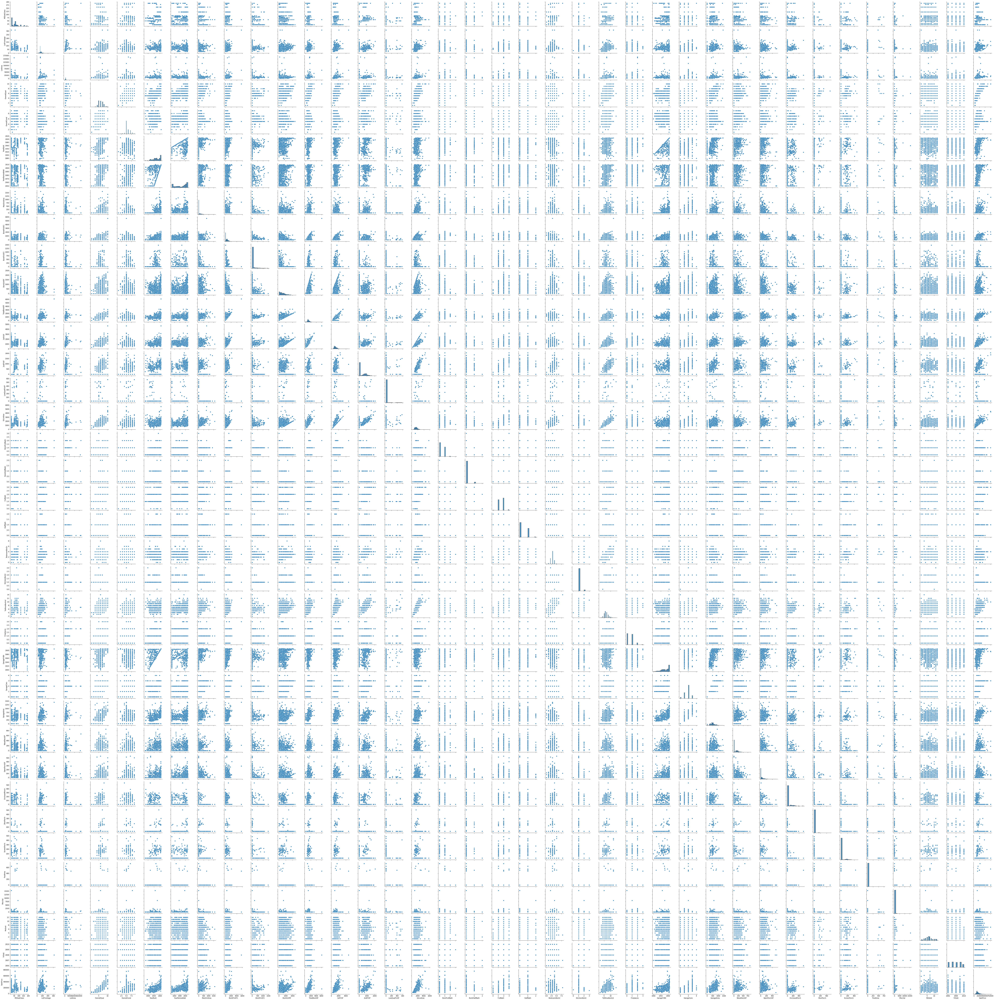

In [33]:
#using multivariate analysis to analyise continuous data
sns.pairplot(df_continuous)

Since, the data is huge and contains too many variables, the cummulative analysis of data is difficult to make. Though we can still observe some independent variables making a positive correlation with the target variable. We will try to understand this data using correlations.

Converting Nominal data into numeric data representation is very important in order to understand data appropriately. Hence, we will use data encoding techniques to convert string values into floating numbers.

# Encoding of DataFrame

In [34]:
#Importing library for encoding and creating instance for the same 
from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

In [35]:
#Converting object datatype into float values
for i in df.columns:
    if df[i].dtypes=='object':
        df[i]=enc.fit_transform(df[i].values.reshape(-1,1))

In [36]:
#Verifying Conversion 
df.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,3.0,60.0,4928,1.0,0.0,3.0,4.0,0.0,13.0,2.0,2.0,4.0,2.0,6,5,1976,1976,1.0,1.0,8.0,9.0,2.0,0.0,3.0,4.0,1.0,2.0,3.0,3.0,0.0,120,5.0,0,958,1078,1.0,4.0,1.0,4.0,958,0,0,958,0,0,2,0,2,1,3.0,5,6.0,1,4.0,1.0,1977.0,1.0,2,440,4.0,4.0,2.0,0,205,0,0,0,0,0,2,2007,8.0,4.0,128000
1,20,3.0,95.0,15865,1.0,0.0,3.0,4.0,1.0,12.0,2.0,2.0,0.0,2.0,8,6,1970,1970,0.0,5.0,12.0,13.0,2.0,0.0,2.0,2.0,2.0,3.0,1.0,1.0,0.0,351,4.0,823,1043,2217,1.0,0.0,1.0,4.0,2217,0,0,2217,1,0,2,0,4,1,2.0,8,6.0,1,4.0,1.0,1970.0,2.0,2,621,4.0,4.0,2.0,81,207,0,0,224,0,0,10,2007,8.0,4.0,268000
2,60,3.0,92.0,9920,1.0,0.0,3.0,1.0,0.0,15.0,2.0,2.0,0.0,5.0,7,5,1996,1997,1.0,1.0,7.0,7.0,2.0,0.0,2.0,4.0,2.0,2.0,3.0,0.0,2.0,862,5.0,0,255,1117,1.0,0.0,1.0,4.0,1127,886,0,2013,1,0,2,1,3,1,3.0,8,6.0,1,4.0,1.0,1997.0,2.0,2,455,4.0,4.0,2.0,180,130,0,0,0,0,0,6,2007,8.0,4.0,269790
3,20,3.0,105.0,11751,1.0,0.0,3.0,4.0,0.0,14.0,2.0,2.0,0.0,2.0,6,6,1977,1977,3.0,1.0,8.0,9.0,1.0,480.0,3.0,4.0,1.0,2.0,3.0,3.0,1.0,705,5.0,0,1139,1844,1.0,0.0,1.0,4.0,1844,0,0,1844,0,0,2,0,3,1,3.0,7,6.0,1,4.0,1.0,1977.0,1.0,2,546,4.0,4.0,2.0,0,122,0,0,0,0,0,1,2010,0.0,4.0,190000
4,20,3.0,60.0,16635,1.0,0.0,3.0,2.0,0.0,14.0,2.0,2.0,0.0,2.0,6,7,1977,2000,1.0,1.0,4.0,4.0,3.0,126.0,2.0,4.0,1.0,2.0,3.0,3.0,0.0,1246,5.0,0,356,1602,1.0,2.0,1.0,4.0,1602,0,0,1602,0,1,2,0,3,1,2.0,8,6.0,1,4.0,1.0,1977.0,0.0,2,529,4.0,4.0,2.0,240,0,0,0,0,0,0,6,2009,8.0,4.0,215000


We can observe that our object datatype has been now converted into float values.

# Describe Data

In [37]:
#Describing present columns in the dataset
df.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood',
       'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl',
       'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical',
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr',
       'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces',
       'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish',
       'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive',
       'WoodDeckSF', 'OpenPorchS

In [38]:
#Defining Shape
df.shape

(1168, 75)

In [39]:
#Describing mean, median, min, max values of data
df.describe()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
count,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000
mean,56.767979,3.013699,68.975171,10484.749144,0.996575,1.938356,2.773973,3.004281,0.064212,12.145548,2.032534,2.005993,0.476027,3.043664,6.104452,5.595890,1970.930651,1984.758562,1.402397,1.086473,8.659247,9.363014,1.758562,101.696918,2.530822,3.725171,1.395548,2.282534,2.802226,2.273116,2.798801,444.726027,4.713185,46.647260,569.721747,1061.095034,1.035959,1.569349,0.933219,3.688356,1169.860445,348.826199,6.380137,1525.066781,0.425514,0.055651,1.562500,0.388699,2.884418,1.045377,2.328767,6.542808,5.742295,0.617295,2.389555,2.225171,1979.717466,1.233733,1.776541,476.860445,3.872432,3.905822,1.853596,96.206336,46.559932,23.015411,3.639555,15.051370,3.448630,47.315068,6.344178,2007.804795,7.465753,3.768836,181477.005993
std,41.940650,0.633120,22.836520,8957.442311,0.058445,1.412262,0.710027,1.642667,0.284088,6.010364,0.871703,0.250035,1.180870,1.898625,1.390153,1.124343,30.145255,20.785185,0.832539,0.642848,3.097443,3.462380,0.611174,182.218483,0.699425,0.744463,0.709379,0.857830,0.674746,1.144218,1.837839,462.664785,0.925186,163.520016,449.375525,442.272249,0.302078,1.749129,0.249749,1.042606,391.161983,439.696370,50.892844,528.042957,0.521615,0.236699,0.551882,0.504929,0.817229,0.216292,0.832992,1.598484,0.987250,0.650575,0.905923,1.767017,25.012983,0.809747,0.745554,214.466769,0.592724,0.503323,0.501894,126.158988,66.381023,63.191089,29.088867,55.080816,44.896939,543.264432,2.686352,1.329738,1.619459,1.112208,79105.586863
min,20.000000,0.000000,21.000000,1300.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1875.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,0.000000,0.000000,34900.000000
25%,20.000000,3.000000,60.000000,7621.500000,1.000000,0.000000,3.000000,2.000000,0.000000,7.000000,2.000000,2.000000,0.000000,2.00

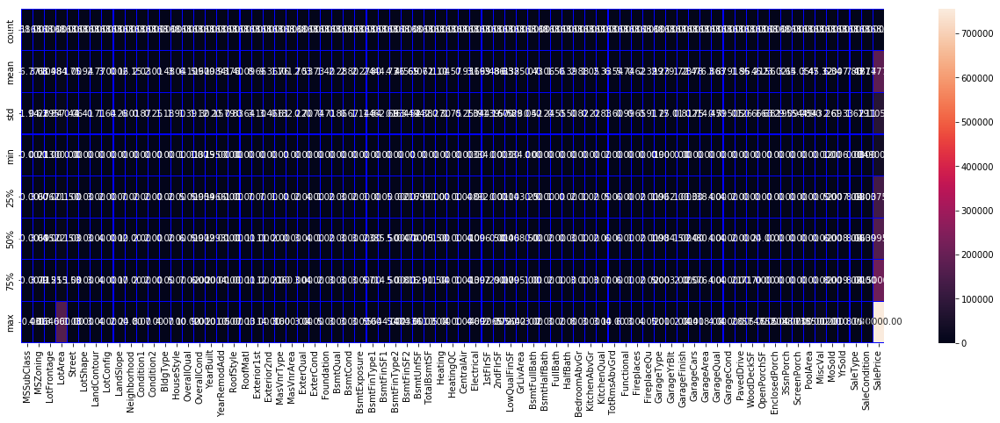

In [40]:
#Visualizing data description
import matplotlib.pyplot as plt
plt.figure(figsize=(22,7))
sns.heatmap(df.describe(),annot=True,linewidths=0.1,linecolor='blue',fmt='0.2f')

# Observation:

The standard deviation of few columns in the dataset are huge which means that the values in these columns are largely scattered and are not near to the mean values. They are very far away from their mean values. The standard devation of other columns is not too high which shows us a normal distribution of data and no skewness.

We assume that since the min & max values in every column contains a range difference, it indicates a possibility of having few outliers and skewness in data.

The only columns to have high values in the data set is the target variable 'SalePrice' and 'LotArea'.

The data does not contain negative values in any of it's variables.

# Correlation of Columns with the Target Variable

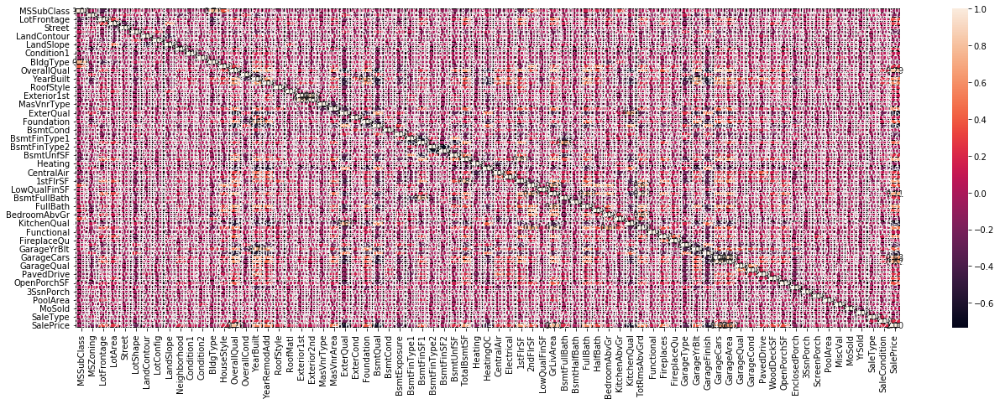

In [41]:
#Plotting correlation of input features with the target Variable
plt.figure(figsize=(22,7))
sns.heatmap(df.corr(),annot=True,linewidths=0.1,linecolor='black',fmt='0.2f')

Observations:

Many positive correlations of independent variables can be seen with the 'SalePrice' target variable.

Since there are lots of variables present in the data set we are not able to see correlations of variables clearly in the above diagram.

Hence, we will sort the correlations of independent variables with the target variable in an ascending order to understand how highly or how low the variables are correlated.

In [42]:
#Sorting correlation in order with the Target Variable
corr_matrix=df.corr()
corr_matrix['SalePrice'].sort_values(ascending=False)

SalePrice        1.000000
OverallQual      0.789185
GrLivArea        0.707300
GarageCars       0.628329
GarageArea       0.619000
TotalBsmtSF      0.595042
1stFlrSF         0.587642
FullBath         0.554988
TotRmsAbvGrd     0.528363
YearBuilt        0.514408
YearRemodAdd     0.507831
MasVnrArea       0.460535
Fireplaces       0.459611
GarageYrBlt      0.381997
Foundation       0.374169
BsmtFinSF1       0.362874
OpenPorchSF      0.339500
2ndFlrSF         0.330386
LotFrontage      0.319414
WoodDeckSF       0.315444
HalfBath         0.295592
LotArea          0.249499
CentralAir       0.246754
Electrical       0.234621
PavedDrive       0.231707
SaleCondition    0.217687
BsmtUnfSF        0.215724
BsmtFullBath     0.212924
HouseStyle       0.205502
Neighborhood     0.198942
RoofStyle        0.192654
RoofMatl         0.159865
BedroomAbvGr     0.158281
GarageCond       0.135071
Functional       0.118673
ExterCond        0.115167
Exterior1st      0.108451
Condition1       0.105820
PoolArea    

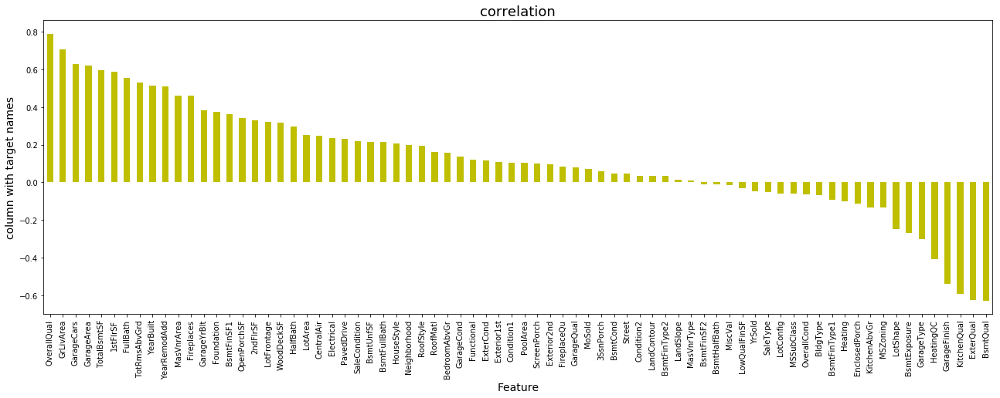

In [43]:
#Plotting Correlation in order with the target variable to see which variables are more correlated
plt.figure(figsize=(22,7))
df.corr()['SalePrice'].sort_values(ascending=False).drop(['SalePrice']).plot(kind='bar',color='y')
plt.xlabel('Feature',fontsize=14)
plt.ylabel('column with target names',fontsize=14)
plt.title('correlation',fontsize=18)
plt.show()

23 variables out of 76 are negatively correlated to the target variable, rest all other are postively correlated.

The most negatively correlated variables to the target variable are 'BsmtQual' & 'ExterQual'.

There are many high positive correlations in the data.

Since variables 'BsmtFinSF2', 'BsmtHalfBath' & 'MiscVal' are correlated to the target variable at -0.01% which hardly shows any correlation so we can delete these columns.

The most positively correlated columns to the target variable are 'OverallQual', 'GrLivArea' and 'GarageCars'.

# Checking skewness

In [44]:
#checking skewness to see if the data is normally distributed
df.skew()

MSSubClass        1.422019
MSZoning         -1.796785
LotFrontage       2.815783
LotArea          10.659285
Street          -17.021969
LotShape         -0.603775
LandContour      -3.125982
LotConfig        -1.118821
LandSlope         4.812568
Neighborhood      0.043735
Condition1        3.008289
Condition2       11.514458
BldgType          2.318657
HouseStyle        0.285680
OverallQual       0.175082
OverallCond       0.580714
YearBuilt        -0.579204
YearRemodAdd     -0.495864
RoofStyle         1.498560
RoofMatl          7.577352
Exterior1st      -0.612816
Exterior2nd      -0.592349
MasVnrType       -0.104609
MasVnrArea        2.835718
ExterQual        -1.810843
ExterCond        -2.516219
Foundation       -0.002761
BsmtQual         -1.343781
BsmtCond         -3.293554
BsmtExposure     -1.166987
BsmtFinType1     -0.068901
BsmtFinSF1        1.871606
BsmtFinType2     -3.615783
BsmtFinSF2        4.365829
BsmtUnfSF         0.909057
TotalBsmtSF       1.744591
Heating          10.103609
H

Keeping threshold +/-0.5 as the range for skewness, we can see high skewness in few variables such as 'LotArea', 'LowQualFinSF', '3SsnPorch', 'PoolArea' and 'MiscVal'. The skewness in these variables needs to be reduced in order to process data for analysis. Before dealing with the skewness, we'll first check outliers in data.

We'll first visualizie skewness before checking outliers.

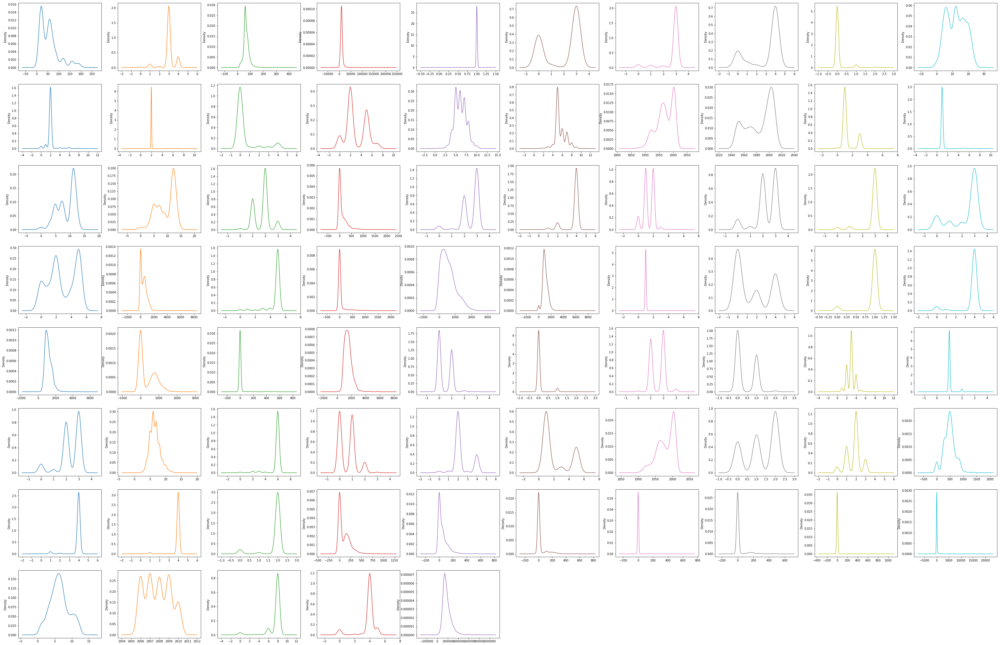

In [45]:
#Visualizing skewness on density graph
#Example of multi variate analysis
df.plot(kind='density',subplots=True,layout=(8,10),legend=False,sharex=False,figsize=(60,40))
plt.show()

The maximum values are observed to be 0 in many numeric value variables from the above graph.

Hence, we can observe high skewness in some of the variables.

First will check outliers in data.

# Checking Outliers


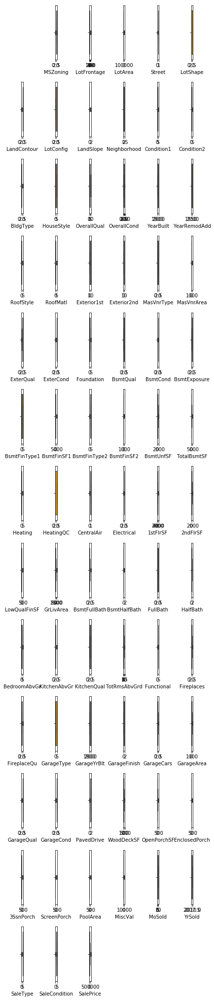

In [46]:
#Visualizing outliers of different variables
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
#Visualizing outliers of different variables
collist=df.columns.values
ncol=6
nrows=14
plt.figure(figsize=(ncol,5*ncol))
for i in range(1,len(collist)):
    plt.subplot(nrows,ncol,i+1)
    sns.boxplot(df[collist[i]],color='orange',orient='v')
    plt.tight_layout()

We can see too many outliers present in the dataset. Tried removing outliers but it is giving an information loss of 58.73% which is huge data, hence data removal is not preffered. So instead of removing outliers, data transformation using power transfrom is applied on data to normalize it.

# Separating the Column into x & y

In [47]:
#Creating x & y columns 
x=df.drop('SalePrice',axis=1)
y=df['SalePrice']

Separating the columns into x & y as input featues and target variable respectively.

# Resolving Skewness using Power Transform

In [48]:
#Using power transform to remove skewness
from sklearn.preprocessing import power_transform
import warnings
warnings.filterwarnings('ignore')
hf=power_transform(x,method='yeo-johnson')

hf=pd.DataFrame(hf,columns=x.columns)

In [49]:
#Verifying skewness
hf.skew()

MSSubClass        0.064007
MSZoning          0.233113
LotFrontage       0.089554
LotArea           0.032509
Street          -17.021969
LotShape         -0.594207
LandContour      -2.592303
LotConfig        -1.030401
LandSlope         3.954345
Neighborhood     -0.146541
Condition1        0.225468
Condition2        0.537277
BldgType          1.857194
HouseStyle       -0.080331
OverallQual       0.021658
OverallCond       0.048063
YearBuilt        -0.126641
YearRemodAdd     -0.225131
RoofStyle        -0.292233
RoofMatl         -6.314987
Exterior1st      -0.338023
Exterior2nd      -0.352793
MasVnrType       -0.016203
MasVnrArea        0.439526
ExterQual        -0.605112
ExterCond        -2.270791
Foundation        0.004296
BsmtQual         -0.413999
BsmtCond         -3.025865
BsmtExposure     -0.914214
BsmtFinType1     -0.206639
BsmtFinSF1       -0.404528
BsmtFinType2     -2.420885
BsmtFinSF2        2.394737
BsmtUnfSF        -0.284390
TotalBsmtSF       0.286779
Heating          -4.541694
H

Skewness in some features are resolved but still can be seen in few variables even after applying transformation methods.

In few variables, even though the skewness is high we cannot clear those variables from the data set because it has good correlation with the target variable and few variables have categorical data where we don't consider having skewness or outliers. 

Hence, we will proceed with scaling data using Standard Scaler.

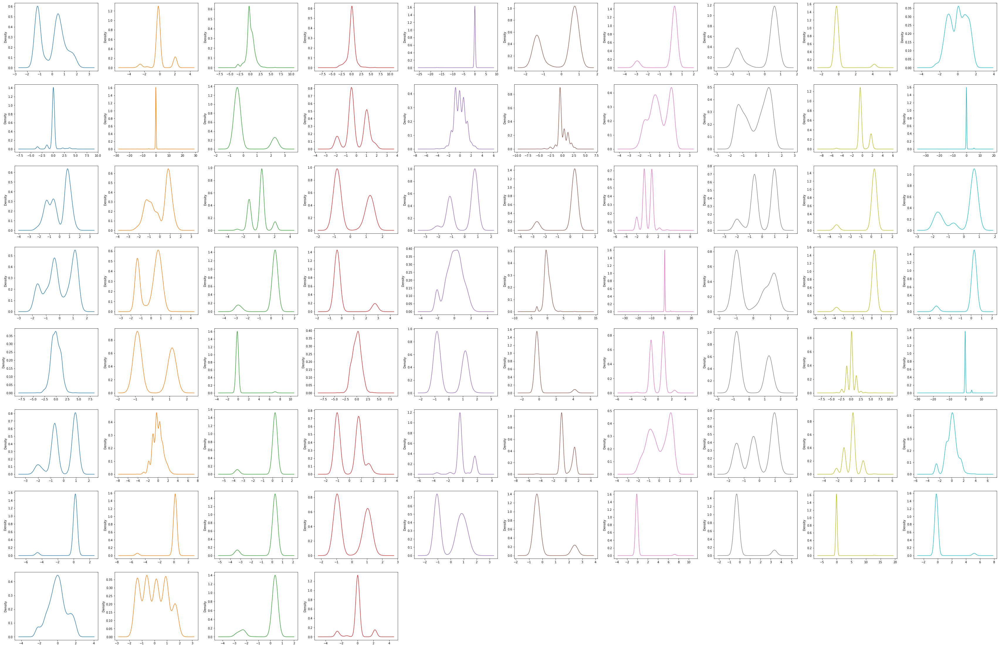

In [50]:
#Visualizing skewness after applying transformations on density graph
hf.plot(kind='density',subplots=True,layout=(8,10),legend=False,sharex=False,figsize=(60,40))
plt.show()

Many graphs have been normalized after applying transformations on data.

# Scaling Data Using Standard Scaler

In [51]:
#importing library for scaling
from sklearn.preprocessing import StandardScaler
import warnings
warnings.filterwarnings('ignore')

In [52]:
#Scaling our data to improve model performance
sc=StandardScaler()
x=sc.fit_transform(hf)
x

array([[ 1.37043472, -0.16245555, -0.32706464, ..., -0.60482475,
         0.40906852,  0.02973497],
       [-1.16799937, -0.16245555,  1.19479958, ..., -0.60482475,
         0.40906852,  0.02973497],
       [ 0.4900471 , -0.16245555,  1.08266809, ..., -0.60482475,
         0.40906852,  0.02973497],
       ...,
       [ 1.70079775, -0.16245555, -2.87014809, ...,  0.899557  ,
         0.40906852,  0.02973497],
       [ 0.69655685, -2.92646435, -0.88298015, ...,  0.14805187,
         0.40906852,  0.02973497],
       [ 0.4900471 , -0.16245555, -0.32706464, ..., -1.35902113,
         0.40906852,  0.02973497]])

Hence, the data is Scaled.

Since our Target Variable has continuous values, we use Linear Regression Algorithm.

# Model Building

In [53]:
#Importing libraries to build linear model
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings('ignore')

In [54]:
#Finding Max accuracy at the best random state
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.22,random_state=i)
    lr=LinearRegression()
    lr.fit(x_train,y_train)
    pred=lr.predict(x_test)
    acc=r2_score(y_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print('Best accuracy is ',maxAccu," on Random_state",maxRS)

Best accuracy is  0.8590487295062788  on Random_state 140


We are getting 85.90% accuracy at random state 140. Hence, we select random state as 140.

In [55]:
#Splitting the data into 80% training and 20% testing
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=.20,random_state=140)

We split our data into Training and Testing giving 80% data for Training and 20% for Testing at best random state 140. We will use linear Regression to train our model as we have a continuous type of values in Target Variable 'SalePrice'.

In [56]:
#Code for Linear Regression
lm=LinearRegression()
lm.fit(x_train,y_train)
pred=lm.predict(x_test)

In [57]:
#displaying predicted and actual values
print("Predicted Happiness Score: ",pred)
print('actual Happiness Score: ',y_test)

Predicted Happiness Score:  [107829.40092634 221907.68241733 293089.16858084 141582.6608985
 288582.89115361 228567.800802   153402.5079979  387959.04361048
 157458.12431913 147212.02781111  78869.53848907 183622.97085365
  88399.49128781 203451.23991203 298320.04021502 173481.45995034
 263725.90172662 282919.75440604 167506.91751722 219081.01292777
 108491.03878404 124582.39053587 276881.61275552 131310.17494894
 330409.26465938 283758.88233124 112546.91767275 191765.36831856
 162235.20423832 215367.38596694 124360.23513084 202476.10942716
  57792.48041964 219503.10715612 163844.74949767 262145.73151571
  51001.86356157 267844.33682151 249958.84527645 116041.89004954
 166259.32010415 185148.07729915 126229.61480285 212910.68668998
 226121.05537859 234866.72522541  95680.7113408  318633.41524987
 170448.64975656  88561.60509487 112726.17978902 212233.13885719
 264066.44920076 111270.6568714  199754.55391323 257395.84923842
 117312.05211721 207956.1057121  137811.76274606 171130.1959555

Let's check the Training accuracy and see how well we have trained our model.

In [58]:
#training score
lm.score(x_train,y_train)

0.8241459430904853

We are obtaining 82.41% training accuracy for our Model. Let's try finding errors.

In [59]:
#Finding Errors
print('error:')
print('Mean absolute error:',mean_absolute_error(y_test,pred))
print('Mean squared error:',mean_squared_error(y_test,pred))

print('Root Mean squared error:',np.sqrt(mean_squared_error(y_test,pred)))

error:
Mean absolute error: 19339.45671878696
Mean squared error: 702194636.2020323
Root Mean squared error: 26498.95537944906


We can observe errors in our model which we can try to minimise it using different regularization and ensemble techniques. Let's check the r2 score to check the performance of our model.

In [60]:
#r2 score of the model
print(r2_score(y_test,pred))

0.8703279818996265


We are obtaining our r2 score as 87.03% which can also be due to overfitting or underfitting problems. Hence, we will use cross Validation to cross check if the model's performing accurately.

# Cross Validation of The Model

In [61]:
#Finding best cv score at a particular cv
pred_train=lr.predict(x_train)
pred_test=lr.predict(x_test)
train_accuracy=r2_score(y_train,pred_train)
test_accuracy=r2_score(y_test,pred_test)

from sklearn.model_selection import cross_val_score
for j in range(2,10):
    cv_score=cross_val_score(lr,x,y,cv=j)
    cv_mean=cv_score.mean()
    print(f"At cross fold {j} the cv score is {cv_mean} and r2 score for training is {train_accuracy} and accuracy for the testing is {test_accuracy}")
    print("\n")

At cross fold 2 the cv score is 0.7391008704341266 and r2 score for training is 0.8150371569201488 and accuracy for the testing is 0.8777970958676596


At cross fold 3 the cv score is 0.7472650694390158 and r2 score for training is 0.8150371569201488 and accuracy for the testing is 0.8777970958676596


At cross fold 4 the cv score is 0.7636424673826714 and r2 score for training is 0.8150371569201488 and accuracy for the testing is 0.8777970958676596


At cross fold 5 the cv score is 0.7532680554894462 and r2 score for training is 0.8150371569201488 and accuracy for the testing is 0.8777970958676596


At cross fold 6 the cv score is 0.7677819754332676 and r2 score for training is 0.8150371569201488 and accuracy for the testing is 0.8777970958676596


At cross fold 7 the cv score is 0.7648900914924471 and r2 score for training is 0.8150371569201488 and accuracy for the testing is 0.8777970958676596


At cross fold 8 the cv score is 0.7681504466919475 and r2 score for training is 0.815037

Here we have handled the problem or overfitting and underfitting by checking the training and testing score at it's highest cv score. Let's try checking if we are covering all the points to attain accuracy by Visualizing it.

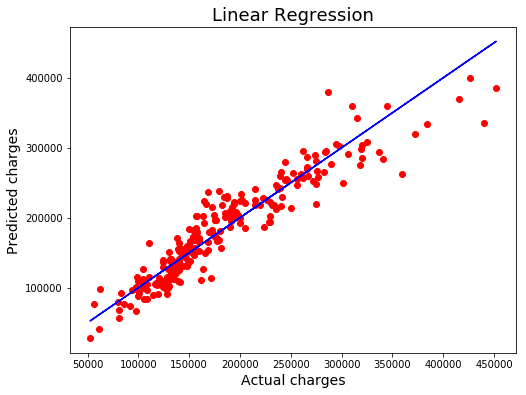

In [62]:
#Code for checking linear Regression data points with target variale
import matplotlib.pyplot as plt
plt.figure(figsize=(8,6))
plt.scatter(x=y_test,y=pred_test,color='r')
plt.plot(y_test,y_test,color='b')
plt.xlabel('Actual charges',fontsize=14)
plt.ylabel('Predicted charges',fontsize=14)
plt.title('Linear Regression',fontsize=18)
plt.show()

The Best Fit line is covering many datapoints and can be seen near to the actual values which shows quite a good fit of our model.

Now, we will try to use different testing techniques and compare them to achieve the best performance for the model and also deal with it's over fitting and under fitting problems and then save the best model with high performance. We are going to use hyper parameter tuning for doing so.

# Regularization

##### Using ElasticNet Regression

In [63]:
#Importing Libraries for hyper parameter tuning 
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score
import warnings
warnings.filterwarnings('ignore')

In [64]:
#Using ElasticNet Regression for our Model to solve overfitting and underfitting
from sklearn.linear_model import ElasticNet

parameters={'alpha':[.0001,.001,.01,.1,1,10],'random_state':list(range(0,10)),'selection':['cyclic','random']}
en=ElasticNet()
clf=GridSearchCV(en,parameters)
clf.fit(x_train,y_train)

print(clf.best_params_)

{'alpha': 1, 'random_state': 9, 'selection': 'random'}


In [65]:
#Code for ElasticNet Regression
en=ElasticNet(alpha=1,random_state=3,selection='random')
en.fit(x_train,y_train)
en.score(x_train,y_train)
pred_en=en.predict(x_test)

enn=r2_score(y_test,pred_en)
enn

0.8749817373796024

The r2 score for ElasticNet Regression is 87.49%. 

##### Using Ridge Regression

In [66]:
#Using Ridge Regression for our Model to solve overfitting and underfitting
from sklearn.linear_model import Ridge

parameters={'alpha':[.0001,.001,.01,.1,1,10],'random_state':list(range(0,10)),'solver':['auto','svd','cholesky']}
rd=Ridge()
clf=GridSearchCV(rd,parameters)
clf.fit(x_train,y_train)

print(clf.best_params_)

{'alpha': 10, 'random_state': 0, 'solver': 'svd'}


In [67]:
#Code for Ridge Regression
rd=Ridge(alpha=10,random_state=0,solver='svd')
rd.fit(x_train,y_train)
rd.score(x_train,y_train)
pred_rd=rd.predict(x_test)

rdd=r2_score(y_test,pred_rd)
rdd

0.8716682156607359

The r2 score for Ridge Regression is 87.16%

##### Using Lasso Regression

In [68]:
#Using Lasso Regression for our Model to solve overfitting and underfitting
from sklearn.linear_model import Lasso

parameters={'alpha':[.0001,.001,.01,.1,1,10],'random_state':list(range(0,10)),'selection':['cyclic','random']}
ls=Lasso()
clf=GridSearchCV(ls,parameters)
clf.fit(x_train,y_train)

print(clf.best_params_)

{'alpha': 10, 'random_state': 9, 'selection': 'random'}


In [69]:
#Code for Lasso Regression
ls=Ridge(alpha=10,random_state=1)
ls.fit(x_train,y_train)
ls.score(x_train,y_train)
pred_ls=ls.predict(x_test)

lss=r2_score(y_test,pred_ls)
lss

0.8716682156607355

The r2 score for Lasso Regression is also 87.16%.

Hence, comparing all the three regularization techniques for regression i.e. ElasticNet, Ridge and Lasso, the model performs best for ElasticNet Regularization Regression technique at r2 score 87.49%. 

# Ensemble Techniques

##### AdaBoostRegressor

In [70]:
#Finding best Parameters for Ada Boost Regressor
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import AdaBoostRegressor

parameters={'random_state':list(range(0,10))}
ab=AdaBoostRegressor()
clf=GridSearchCV(ab,parameters)
clf.fit(x_train,y_train)

print(clf.best_params_)

{'random_state': 5}


In [71]:
#Code for Ada Boost Regressor
ab=AdaBoostRegressor(random_state=4, n_estimators=100)
ab.fit(x_train,y_train)
ab.score(x_train,y_train)
pred_y=ab.predict(x_test)

abs=r2_score(y_test,pred_y)
print('R2 score: ',abs*100)

R2 score:  81.32043977547069


In [72]:
#Finding the Cv score of the model
abscore=cross_val_score(ab,x,y,cv=8)
abc=abscore.mean()
print("Cross Val Score: ",abc*100)

Cross Val Score:  78.90080677899817


The r2 score for Ada Boost Regressor is 81.32% and that for it's cv score is 78.9% which does not give us much of a good performance model.

Hence, we will try using Random Forest Regressor algorithm for better performance.

###### RandomForestRegressor

In [73]:
#Finding best Parameters for RandomForestRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

parameters={'random_state':list(range(0,10)),'criterion':['mse','mae']}
rfg=RandomForestRegressor()
clf=GridSearchCV(rfg,parameters)
clf.fit(x_train,y_train)

print(clf.best_params_)

{'criterion': 'mae', 'random_state': 4}


In [74]:
#Code for RandomForestRegressor
rfg=RandomForestRegressor(random_state=9, n_estimators=100, criterion='mse')
rfg.fit(x_train,y_train)
rfg.score(x_train,y_train)
pred_y=rfg.predict(x_test)

abs=r2_score(y_test,pred_y)
print('R2 score: ',abs*100)

R2 score:  87.56475423772112


In [75]:
#Finding the Cv score of the model
abscore1=cross_val_score(rfg,x,y,cv=8)
abc1=abscore1.mean()
print("Cross Val Score: ",abc1*100)

Cross Val Score:  85.13030521823946


The r2 score for RandomForestRegressor is 87.56% and it's cv score is 85.13% which has the best performance among all the other algorithms used for testing the performance of the model. The performance of ElasticNet Regularization technique is also good which is 87.49% where as for Random Forest Regressor is 87.56% which is a little better than the regularization technique. Hence, we use the RandomForestRegressor Ensemble technique for this model and save it as our best model. 

# Saving The Best Model

In [76]:
#Saving the best model
import pickle
filename='housing.pkl'
pickle.dump(rfg,open(filename,'wb'))

# Testing Dataset


# Data Description
The test data consists of the similar variables as present in the train data set except the "Target Variable" but the number of records in the test data set is comparatively less than that of train data set. This data set is used to predict values of houses using the independent variables present in the data.


In [77]:
# Importing Testing Dataset
df1=pd.read_csv(r'C:\Users\HP-15\housing_train.csv')
#Visualizing Test dataset
df1

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,127,120,RL,NaN,4928,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,NaN,NaN,NaN,0,2,2007,WD,Normal,128000
1,889,20,RL,95.0,15865,Pave,NaN,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,NaN,NaN,NaN,0,10,2007,WD,Normal,268000
2,793,60,RL,92.0,9920,Pave,NaN,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,NaN,NaN,NaN,0,6,2007,WD,Normal,269790
3,110,20,RL,105.0,11751,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,NaN,MnPrv,NaN,0,1,2010,COD,Normal,190000
4,422,20,RL,NaN,16635,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,NaN,NaN,NaN,0,6,2009,WD,Normal,215000
5,1197,60,RL,58.0,14054,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,7,5,2006,2006,Gable,CompShg,VinylSd,VinylSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,Unf,0,Unf,0,879,879,GasA,Ex,Y,SBrkr,879,984,0,1863,0,0,2,1,4,1,Gd,9,Typ,1,Gd,BuiltIn,2006.0,Fin,3,660,TA,TA,Y,100,17,0,0,0,0,NaN,NaN,NaN,0,11,2006,New,Partial,219210
6,561,20,RL,NaN,11341,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,6,1957,1996,Hip,CompShg,Wd Sdng,Wd Sdng,BrkFace,180.0,TA,TA,CBlock,Gd,TA,No,ALQ,1302,Unf,0,90,1392,GasA,TA,Y,SBrkr,1392,0,0,1392,1,0,1,1,3,1,TA,5,Mod,1,Gd,Detchd,1957.0,Unf,2,528,TA,TA,Y,0,0,0,0,95,0,NaN,NaN,NaN,0,5,2010,WD,Normal,121500
7,1041,20,RL,88.0,13125,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Sawyer,Norm,Norm,1Fam,1Story,5,4,1957,2000,Gable,CompShg,Wd Sdng,Wd Sdng,BrkCmn,67.0,TA,TA,CBlock,TA,TA,No,Rec,168,BLQ,682,284,1134,GasA,Ex,Y,SBrkr,1803,0,0,1803,1,0,2,0,3,1,TA,8,Maj1,1,TA,Attchd,1957.0,RFn,2,484,TA,TA,Y,0,0,0,0,0,0,NaN,GdPrv,NaN,0,1,2006,WD,Normal,155000
8,503,20,RL,70.0,9170,Pave,NaN,Reg,Lvl,AllPub,Corner,Gtl,Edwards,Feedr,Norm,1Fam,1Story,5,7,1965,1965,Hip,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,ALQ,698,GLQ,96,420,1214,GasA,Ex,Y,SBrkr,1214,0,0,1214,1,0,1,0,2,1,TA,6,Typ,0,NaN,Detchd,1965.0,Unf,2,461,Fa,Fa,Y,0,0,184,0,0,0,NaN,GdPrv,Shed,400,4,2007,WD,Normal,140000
9,576,50,RL,80.0,8480,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1.5Fin,5,5,1947,1950,Gable,CompShg,MetalSd,MetalSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,442,Unf,0,390,832,Gas

In [78]:
#Initial variables in the test dataset (before data pre-processing)
df1.columns

Index(['Id', 'MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'Alley', 'LotShape', 'LandContour', 'Utilities', 'LotConfig',
       'LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType',
       'HouseStyle', 'OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd',
       'RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType',
       'MasVnrArea', 'ExterQual', 'ExterCond', 'Foundation', 'BsmtQual',
       'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinSF1',
       'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', 'Heating',
       'HeatingQC', 'CentralAir', 'Electrical', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'KitchenQual',
       'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'FireplaceQu', 'GarageType',
       'GarageYrBlt', 'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual',
       'GarageCond', 'PavedDrive

In [79]:
#Dropping "Id" column from the test dataset just like we did it in he trin data set
df1.drop("Id",axis=1,inplace=True)

In [80]:
#Checking size of present dataset
df1.shape

(1168, 80)

The dataset now consits of 292 rows and 79 columns.

In [81]:
#Checking data types of all the attributes within the data set
df1.dtypes


MSSubClass         int64
MSZoning          object
LotFrontage      float64
LotArea            int64
Street            object
Alley             object
LotShape          object
LandContour       object
Utilities         object
LotConfig         object
LandSlope         object
Neighborhood      object
Condition1        object
Condition2        object
BldgType          object
HouseStyle        object
OverallQual        int64
OverallCond        int64
YearBuilt          int64
YearRemodAdd       int64
RoofStyle         object
RoofMatl          object
Exterior1st       object
Exterior2nd       object
MasVnrType        object
MasVnrArea       float64
ExterQual         object
ExterCond         object
Foundation        object
BsmtQual          object
BsmtCond          object
BsmtExposure      object
BsmtFinType1      object
BsmtFinSF1         int64
BsmtFinType2      object
BsmtFinSF2         int64
BsmtUnfSF          int64
TotalBsmtSF        int64
Heating           object
HeatingQC         object


The data set consists of a combination of 'String', 'int' and 'float' data types.

Since it is very important to check the null values present in the data to clean data before predicting values, hence we first check and resolve null values in data set using "Simple Imputer" techniques.

# Checking Null Values

In [82]:
#Checking Null values
df1.isnull().sum()

MSSubClass          0
MSZoning            0
LotFrontage       214
LotArea             0
Street              0
Alley            1091
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType          7
MasVnrArea          7
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           30
BsmtCond           30
BsmtExposure       31
BsmtFinType1       30
BsmtFinSF1          0
BsmtFinType2       31
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          0
1stFlrSF            0
2ndFlrSF            0
LowQualFinSF        0
GrLivArea 

Since the null(NaN) values present in columns "PoolQC", "Fence", "MiscFeature" & "Alley" are more than 70% of the records in the data set. So the variables does not seem to be of any importance in analysing the sale price, hence removing them from the data set.

The other null values present will be treated using SimpleImputer and Imputer techniques. Null values in data set needs to be treated in order to make an analysis on data.

These are the same steps performed as we did while training the "train" data set. Hence, we have to follow the same procedure in order to predict values for "test" data set.

In [83]:
#Dropping variables with maximum null values i.e. near to 70% of data are null values
df1.drop("PoolQC",axis=1,inplace=True)
df1.drop("Fence",axis=1,inplace=True)
df1.drop("MiscFeature",axis=1,inplace=True)
df1.drop("Alley",axis=1,inplace=True)

In [84]:
#Checking number of variables left in he dataset
df1.shape

(1168, 76)

It is noticable that 4 variables have been dropped from the data set.

Now will treat null values of test data.

In [85]:
#Filling Nan values using 'most_frequent' of simle Imputer for categorical data
from sklearn.impute import SimpleImputer

imp=SimpleImputer(strategy='most_frequent')

df1['GarageQual']=imp.fit_transform(df1['GarageQual'].values.reshape(-1,1))
df1['GarageCond']=imp.fit_transform(df1['GarageCond'].values.reshape(-1,1))
df1['GarageFinish']=imp.fit_transform(df1['GarageFinish'].values.reshape(-1,1))
df1['GarageType']=imp.fit_transform(df1['GarageType'].values.reshape(-1,1))
df1['FireplaceQu']=imp.fit_transform(df1['FireplaceQu'].values.reshape(-1,1))
df1['BsmtFinType2']=imp.fit_transform(df1['BsmtFinType2'].values.reshape(-1,1))
df1['BsmtFinType1']=imp.fit_transform(df1['BsmtFinType1'].values.reshape(-1,1))
df1['BsmtExposure']=imp.fit_transform(df1['BsmtExposure'].values.reshape(-1,1))
df1['BsmtCond']=imp.fit_transform(df1['BsmtCond'].values.reshape(-1,1))
df1['BsmtQual']=imp.fit_transform(df1['BsmtQual'].values.reshape(-1,1))
df1['MasVnrType']=imp.fit_transform(df1['MasVnrType'].values.reshape(-1,1))

df1.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,RL,NaN,4928,Pave,IR1,Lvl,AllPub,Inside,Gtl,NPkVill,Norm,Norm,TwnhsE,1Story,6,5,1976,1976,Gable,CompShg,Plywood,Plywood,None,0.0,TA,TA,CBlock,Gd,TA,No,ALQ,120,Unf,0,958,1078,GasA,TA,Y,SBrkr,958,0,0,958,0,0,2,0,2,1,TA,5,Typ,1,TA,Attchd,1977.0,RFn,2,440,TA,TA,Y,0,205,0,0,0,0,0,2,2007,WD,Normal,128000
1,20,RL,95.0,15865,Pave,IR1,Lvl,AllPub,Inside,Mod,NAmes,Norm,Norm,1Fam,1Story,8,6,1970,1970,Flat,Tar&Grv,Wd Sdng,Wd Sdng,None,0.0,Gd,Gd,PConc,TA,Gd,Gd,ALQ,351,Rec,823,1043,2217,GasA,Ex,Y,SBrkr,2217,0,0,2217,1,0,2,0,4,1,Gd,8,Typ,1,TA,Attchd,1970.0,Unf,2,621,TA,TA,Y,81,207,0,0,224,0,0,10,2007,WD,Normal,268000
2,60,RL,92.0,9920,Pave,IR1,Lvl,AllPub,CulDSac,Gtl,NoRidge,Norm,Norm,1Fam,2Story,7,5,1996,1997,Gable,CompShg,MetalSd,MetalSd,None,0.0,Gd,TA,PConc,Gd,TA,Av,GLQ,862,Unf,0,255,1117,GasA,Ex,Y,SBrkr,1127,886,0,2013,1,0,2,1,3,1,TA,8,Typ,1,TA,Attchd,1997.0,Unf,2,455,TA,TA,Y,180,130,0,0,0,0,0,6,2007,WD,Normal,269790
3,20,RL,105.0,11751,Pave,IR1,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1977,1977,Hip,CompShg,Plywood,Plywood,BrkFace,480.0,TA,TA,CBlock,Gd,TA,No,BLQ,705,Unf,0,1139,1844,GasA,Ex,Y,SBrkr,1844,0,0,1844,0,0,2,0,3,1,TA,7,Typ,1,TA,Attchd,1977.0,RFn,2,546,TA,TA,Y,0,122,0,0,0,0,0,1,2010,COD,Normal,190000
4,20,RL,NaN,16635,Pave,IR1,Lvl,AllPub,FR2,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,7,1977,2000,Gable,CompShg,CemntBd,CmentBd,Stone,126.0,Gd,TA,CBlock,Gd,TA,No,ALQ,1246,Unf,0,356,1602,GasA,Gd,Y,SBrkr,1602,0,0,1602,0,1,2,0,3,1,Gd,8,Typ,1,TA,Attchd,1977.0,Fin,2,529,TA,TA,Y,240,0,0,0,0,0,0,6,2009,WD,Normal,215000


We used "most_frequent" strategy of Simple Imputer to fill null values of categorical data.

Now again we'll check the null values present in data.

In [86]:
#Checking Null values
df1.isnull().sum()

MSSubClass         0
MSZoning           0
LotFrontage      214
LotArea            0
Street             0
LotShape           0
LandContour        0
Utilities          0
LotConfig          0
LandSlope          0
Neighborhood       0
Condition1         0
Condition2         0
BldgType           0
HouseStyle         0
OverallQual        0
OverallCond        0
YearBuilt          0
YearRemodAdd       0
RoofStyle          0
RoofMatl           0
Exterior1st        0
Exterior2nd        0
MasVnrType         0
MasVnrArea         7
ExterQual          0
ExterCond          0
Foundation         0
BsmtQual           0
BsmtCond           0
BsmtExposure       0
BsmtFinType1       0
BsmtFinSF1         0
BsmtFinType2       0
BsmtFinSF2         0
BsmtUnfSF          0
TotalBsmtSF        0
Heating            0
HeatingQC          0
CentralAir         0
Electrical         0
1stFlrSF           0
2ndFlrSF           0
LowQualFinSF       0
GrLivArea          0
BsmtFullBath       0
BsmtHalfBath       0
FullBath     

In [87]:
#Importing Libraries to treat Null values using median
from sklearn.impute import SimpleImputer
import warnings
warnings.filterwarnings('ignore')
imputer = SimpleImputer(missing_values=np.nan, strategy='median')

In [88]:
#treating null values using Simple Imputer
for i in df1.columns:
    if df1[i].isnull().sum()!=0:
        df1[i]=imp.fit_transform(df1[i].values.reshape(-1,1))
        

In [89]:
#Checking null values again
df1.isnull().sum()

MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrType       0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd

We now observe that our null values have been treated. Let's visualize and check if we still have any Null Values.

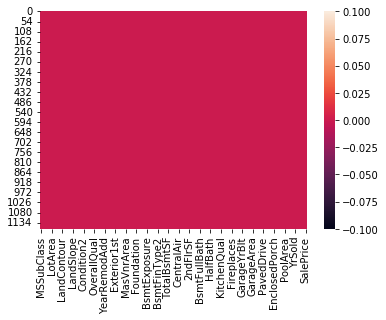

In [90]:
# Visualizing null values through heatmap
import seaborn as sns
sns.heatmap(df1.isnull())

We cannot see any Null Values in our dataset. Hence, we can proceed forward with visualizing our data.

# Making DataFrame for the Nominal Data`

In [91]:
#Copying nominal variables into a new dataframe
df_nominal1=df1[['MSZoning','Street','LotShape', 'LandContour', 'Utilities', 'LotConfig','LandSlope', 'Neighborhood', 'Condition1', 'Condition2', 'BldgType','HouseStyle','RoofStyle', 'RoofMatl', 'Exterior1st', 'Exterior2nd', 'MasVnrType','ExterQual', 'ExterCond', 'Foundation', 'BsmtQual','BsmtCond', 'BsmtExposure', 'BsmtFinType1','BsmtFinType2', 'Heating','HeatingQC', 'CentralAir', 'Electrical','KitchenQual','Functional','FireplaceQu','GarageType','GarageFinish','GarageQual','GarageCond','PavedDrive','SaleType','SaleCondition']].copy()

We create a new separate dataframe to store all categorical data and make an analysis on it separetly. Same procedures that we followed in Training our data set.

In [92]:
#Checking columns of new nominal dataframe created
df_nominal1.columns


Index(['MSZoning', 'Street', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'SaleType', 'SaleCondition'],
      dtype='object')

In [93]:
#Cheking shape of new nominal dataframe
df_nominal1.shape

(1168, 39)

We have 292 rows and 39 columns in the nominal DataFrame.

# Visualization of Data

For the nominal/categorical data we will use countplot as it gives frequency of the columns. Since we have already imported the required libraries earlier, we'll not import them again.

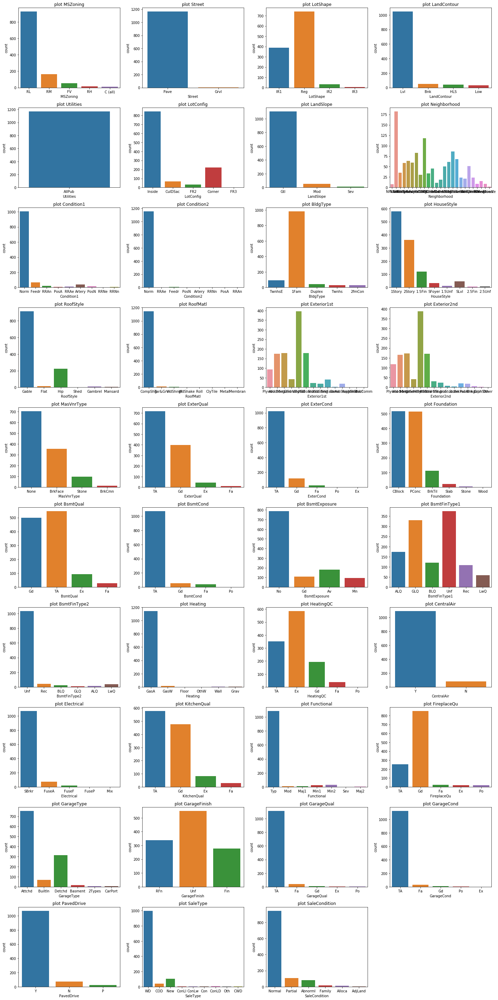

In [94]:
#Visualizing different columns using countplot
ncol,nrow=10,4
ab=df_nominal1.columns.values
plt.figure(figsize=(20,40))
for index,i in enumerate(ab):
    ab=plt.subplot(ncol,nrow,index+1)
    sns.countplot(df1[i])
    plt.title(f"plot {i}")
    plt.tight_layout()
plt.show()

AllPub    1168
Name: Utilities, dtype: int64


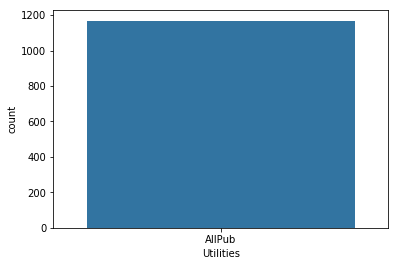

In [95]:
#Visualizing Utilities column separately to get exact figure of values for records
ab=sns.countplot(x='Utilities', data=df_nominal1)
print(df_nominal1['Utilities'].value_counts())

Observation
Since we have deleted the 'Utilities' variable in the Training data set as it contained similar value ("AllPub") for all records but in the above graph we can see 291 records have "AllPub" as its value but only 1 record has a different value i.e. "NoSeWa". Hence, we conclude the column to be of not much importance and delete it for the test data set as well.

'MSZoning' has maximum records for value "RL" and second highest is for "RM".

The most records in "Street" belongs to value "Pave".

The 'LotShape' for most properties is "Reg" and second most is "IR1".

'LandContour' is maximum for "Lvl".

The highest records in 'LotConfig' is for value "Inside LotConfig".

'LandSlope' has maximum records for "Gentle slope".

Variables such as "Neighborhood", "Exterior1st", "Exterior2nd" are unpredictable here as it consists of too many categories but have been separately explained for the train data set.

'Condition1' and 'Condition2' is "Normal" for most of the properties.

'BldgType' is "1Fam-Single-family Detached" for around 240 properties.

'HouseStyle' has values "1Story" and "2Story" for 140+ and 80 records respectively.

'RoofStyle' is "Gable" for more than 200 properties.

'RoofMatl', 'BsmtCond', 'BsmtFinType2' and 'Heating' holds maximum records i.e. 250+ for values "Standard (Composite) Shingle", "Typical - slight dampness allowed", "Unfinshed" and "GasA" respectively.

More than 250 properties have 'CentralAir'.

Variables 'Electrical', 'Functional', 'FireplaceQu' have 250+ records for values "Standard Circuit Breakers & Romex", "Typ" and "Gd".

In [96]:
#dropping column having no importance data since all the values inside the column are same except 1 record, hence does not serve of much importance in both train and test data set.
df1.drop("Utilities",axis=1,inplace=True)

Making DataFrame of the Continuous type of Values

In [97]:
#Copying our continuous data into a new dataframe
df_continuous1=df1[['MSSubClass','LotFrontage','LotArea','OverallQual', 'OverallCond', 'YearBuilt', 'YearRemodAdd','MasVnrArea','BsmtFinSF1','BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF','1stFlrSF', '2ndFlrSF', 'LowQualFinSF','GrLivArea','BsmtFullBath','BsmtHalfBath','FullBath','HalfBath','BedroomAbvGr','KitchenAbvGr','TotRmsAbvGrd','Fireplaces','GarageYrBlt','GarageCars', 'GarageArea','WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch','ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'YrSold']].copy()

In [98]:
#Verifying columns
df_continuous1.columns

Index(['MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual', 'OverallCond',
       'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1', 'BsmtFinSF2',
       'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF', 'LowQualFinSF',
       'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath', 'HalfBath',
       'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd', 'Fireplaces',
       'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF', 'OpenPorchSF',
       'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea', 'MiscVal',
       'MoSold', 'YrSold'],
      dtype='object')

In [99]:
#Cheking shape of new numeric dataframe
df_continuous1.shape

(1168, 36)

Visualizing Continuous Data

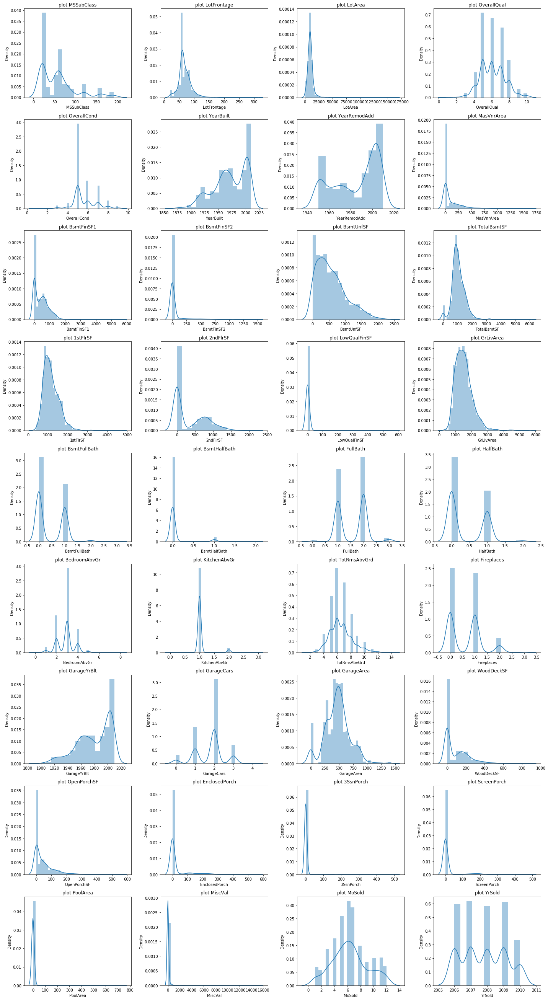

In [100]:
#Visualizing different columns using distplot
ncol,nrow=10,4
ab=df_continuous1.columns.values
plt.figure(figsize=(20,40))
for index,i in enumerate(ab):
    ab=plt.subplot(ncol,nrow,index+1)
    sns.distplot(df1[i])
    plt.title(f"plot {i}")
    plt.tight_layout()
plt.show()

Observation:
The type of dwelling involved in the sale ('MSSubClass') is "20 : 1-STORY 1946 & NEWER ALL STYLES" for most of the cases.

Linear feet of street connected to property ('LotFrontage') is max between the range 50 & 75.

Lot size in square feet ('LotArea') has max records between values 0 & 25000.

Rates the overall material and finish of the house ('OverallQual') has maximum records for values 5, 6 and 7.

Rates the overall condition of the house ('OverallCond') has maximum record for value 5.

Maximum records have Original construction date ('YearBuilt') as 2000.

Maximum records for Remodel date (same as construction date if no remodeling or additions) ['YearRemodAdd'] has values between 2000 and 2010.

The values of most of the properties for Masonry veneer area in square feet ('MasVnrArea') is 0 but the values range between 0 to 1200.

The values of most of the properties for Type 1 finished square feet ('BsmtFinSF1') is 0 but the values range between 0 to 2000 having most of them ranging from 0 to 1000.

The values of most of the properties for Type 2 finished square feet ('BsmtFinSF2') is 0 but the values range between 0 to 1200.

The values for Unfinished square feet of basement area ('BsmtUnfSF') lies max between 0 to 1000.

Total square feet of basement area ('TotalBsmtSF') has max records ranging between values 500 to 2000.

First Floor square feet ('1stFlrSF') has maximum records ranging between values 500 to 1500.

Second floor square feet ('2ndFlrSF') has maximum records at value 0 and also few between values 500 & 1000.

Above grade (ground) living area square feet ('GrLivArea') has maximum records ranging between values 900 to 3000.

Basement full bathrooms ('BsmtFullBath') has more records for value 0 than value 1.

Variables such as 'LowQualFinSF', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea' & 'MiscVal' contains maximum records at value 0.

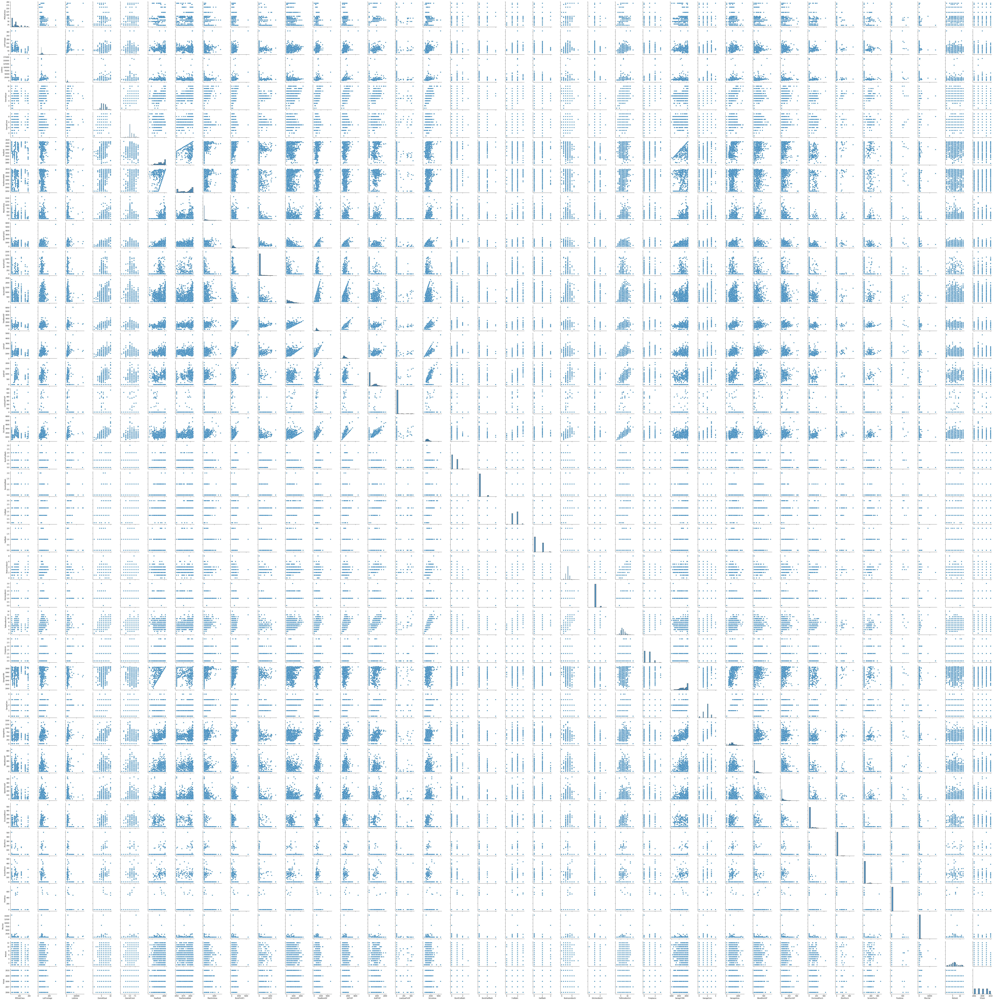

In [101]:
#using multivariate analysis to analyise continuous type of data
sns.pairplot(df_continuous1)

Since, the data is huge and contains too many variables, the cummulative analysis of data is difficult to make. Though we can still observe some independent variables making a positive correlation with the target variable. We will try to understand this data using correlations.

Converting Nominal data into numeric data representation is very important in order to understand data appropriately. Hence, we will use data encoding techniques to convert string values into floating numbers.

# Encoding of DataFrame

In [102]:
#Importing library for encoding and creating instance for the same 
from sklearn.preprocessing import OrdinalEncoder
enc=OrdinalEncoder()

In [103]:
#Converting object datatype into float values
for i in df1.columns:
    if df1[i].dtypes=='object':
        df1[i]=enc.fit_transform(df1[i].values.reshape(-1,1))

In [104]:
#Verifying Conversion 
df1.head()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,120,3.0,60.0,4928,1.0,0.0,3.0,4.0,0.0,13.0,2.0,2.0,4.0,2.0,6,5,1976,1976,1.0,1.0,8.0,9.0,2.0,0.0,3.0,4.0,1.0,2.0,3.0,3.0,0.0,120,5.0,0,958,1078,1.0,4.0,1.0,4.0,958,0,0,958,0,0,2,0,2,1,3.0,5,6.0,1,4.0,1.0,1977.0,1.0,2,440,4.0,4.0,2.0,0,205,0,0,0,0,0,2,2007,8.0,4.0,128000
1,20,3.0,95.0,15865,1.0,0.0,3.0,4.0,1.0,12.0,2.0,2.0,0.0,2.0,8,6,1970,1970,0.0,5.0,12.0,13.0,2.0,0.0,2.0,2.0,2.0,3.0,1.0,1.0,0.0,351,4.0,823,1043,2217,1.0,0.0,1.0,4.0,2217,0,0,2217,1,0,2,0,4,1,2.0,8,6.0,1,4.0,1.0,1970.0,2.0,2,621,4.0,4.0,2.0,81,207,0,0,224,0,0,10,2007,8.0,4.0,268000
2,60,3.0,92.0,9920,1.0,0.0,3.0,1.0,0.0,15.0,2.0,2.0,0.0,5.0,7,5,1996,1997,1.0,1.0,7.0,7.0,2.0,0.0,2.0,4.0,2.0,2.0,3.0,0.0,2.0,862,5.0,0,255,1117,1.0,0.0,1.0,4.0,1127,886,0,2013,1,0,2,1,3,1,3.0,8,6.0,1,4.0,1.0,1997.0,2.0,2,455,4.0,4.0,2.0,180,130,0,0,0,0,0,6,2007,8.0,4.0,269790
3,20,3.0,105.0,11751,1.0,0.0,3.0,4.0,0.0,14.0,2.0,2.0,0.0,2.0,6,6,1977,1977,3.0,1.0,8.0,9.0,1.0,480.0,3.0,4.0,1.0,2.0,3.0,3.0,1.0,705,5.0,0,1139,1844,1.0,0.0,1.0,4.0,1844,0,0,1844,0,0,2,0,3,1,3.0,7,6.0,1,4.0,1.0,1977.0,1.0,2,546,4.0,4.0,2.0,0,122,0,0,0,0,0,1,2010,0.0,4.0,190000
4,20,3.0,60.0,16635,1.0,0.0,3.0,2.0,0.0,14.0,2.0,2.0,0.0,2.0,6,7,1977,2000,1.0,1.0,4.0,4.0,3.0,126.0,2.0,4.0,1.0,2.0,3.0,3.0,0.0,1246,5.0,0,356,1602,1.0,2.0,1.0,4.0,1602,0,0,1602,0,1,2,0,3,1,2.0,8,6.0,1,4.0,1.0,1977.0,0.0,2,529,4.0,4.0,2.0,240,0,0,0,0,0,0,6,2009,8.0,4.0,215000


We can observe that our object datatype has been now converted into float values.

# Describe Data

In [105]:
#Describing present columns in the dataset
df1.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood',
       'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl',
       'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical',
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr',
       'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces',
       'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish',
       'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive',
       'WoodDeckSF', 'OpenPorchS

In [106]:
#Describing present columns in the dataset
df1.columns

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'LotConfig', 'LandSlope', 'Neighborhood',
       'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'RoofStyle', 'RoofMatl',
       'Exterior1st', 'Exterior2nd', 'MasVnrType', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical',
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr',
       'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces',
       'FireplaceQu', 'GarageType', 'GarageYrBlt', 'GarageFinish',
       'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond', 'PavedDrive',
       'WoodDeckSF', 'OpenPorchS

We now have 292 rows and 74 columns in the dataset.

In [107]:
#Describing mean, median, min, max values of data
df1.describe()

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
count,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000,1168.000000
mean,56.767979,3.013699,68.975171,10484.749144,0.996575,1.938356,2.773973,3.004281,0.064212,12.145548,2.032534,2.005993,0.476027,3.043664,6.104452,5.595890,1970.930651,1984.758562,1.402397,1.086473,8.659247,9.363014,1.758562,101.696918,2.530822,3.725171,1.395548,2.282534,2.802226,2.273116,2.798801,444.726027,4.713185,46.647260,569.721747,1061.095034,1.035959,1.569349,0.933219,3.688356,1169.860445,348.826199,6.380137,1525.066781,0.425514,0.055651,1.562500,0.388699,2.884418,1.045377,2.328767,6.542808,5.742295,0.617295,2.389555,2.225171,1979.717466,1.233733,1.776541,476.860445,3.872432,3.905822,1.853596,96.206336,46.559932,23.015411,3.639555,15.051370,3.448630,47.315068,6.344178,2007.804795,7.465753,3.768836,181477.005993
std,41.940650,0.633120,22.836520,8957.442311,0.058445,1.412262,0.710027,1.642667,0.284088,6.010364,0.871703,0.250035,1.180870,1.898625,1.390153,1.124343,30.145255,20.785185,0.832539,0.642848,3.097443,3.462380,0.611174,182.218483,0.699425,0.744463,0.709379,0.857830,0.674746,1.144218,1.837839,462.664785,0.925186,163.520016,449.375525,442.272249,0.302078,1.749129,0.249749,1.042606,391.161983,439.696370,50.892844,528.042957,0.521615,0.236699,0.551882,0.504929,0.817229,0.216292,0.832992,1.598484,0.987250,0.650575,0.905923,1.767017,25.012983,0.809747,0.745554,214.466769,0.592724,0.503323,0.501894,126.158988,66.381023,63.191089,29.088867,55.080816,44.896939,543.264432,2.686352,1.329738,1.619459,1.112208,79105.586863
min,20.000000,0.000000,21.000000,1300.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1875.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,0.000000,0.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,0.000000,0.000000,34900.000000
25%,20.000000,3.000000,60.000000,7621.500000,1.000000,0.000000,3.000000,2.000000,0.000000,7.000000,2.000000,2.000000,0.000000,2.00

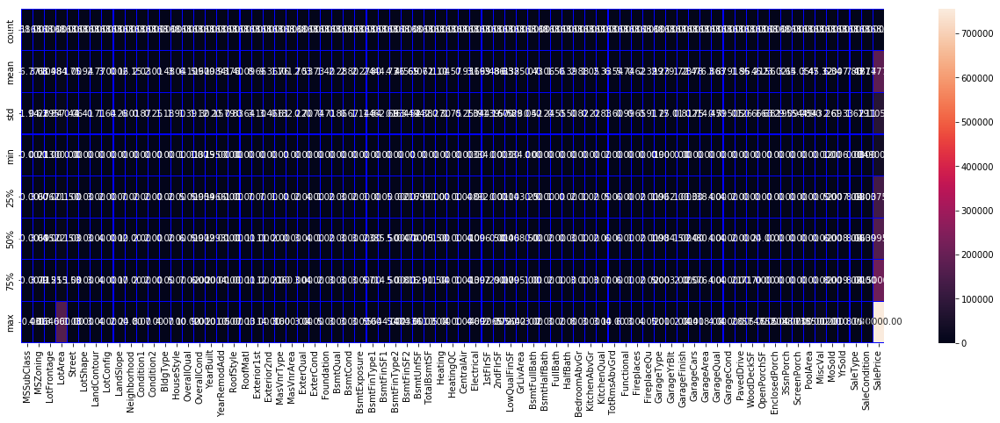

In [108]:
#Visualizing data description
import matplotlib.pyplot as plt
plt.figure(figsize=(22,7))
sns.heatmap(df1.describe(),annot=True,linewidths=0.1,linecolor='blue',fmt='0.2f')

Observation:

The standard deviation of few columns in the dataset are huge which means that the values in these columns are largely scattered and are not near to the mean values. They are very far away from their mean values. The standard devation of other columns is not too high which shows us a normal distribution of data and no skewness.

We assume that since the min & max values in every column contains a range difference, it indicates a possibility of having few outliers and skewness in data.

The only column to have high values in the test data set is the independent variable 'LotArea'.

The data does not contain negative values in any of it's variables.

Correlation of Columns with the Target Variable
Since we don't have the target variable "SalePrice" in the test data set, we cannot find the correlation of independent variables with the dependent/ target variable. We have already found the correlation between the independent variables and target vaiables from the train data set.

The target variable is not available in the test data set because we are going to predict the values of "SalePrice" of test data set with the algorithm trained using the train data set. Hence, no correlations can be found for this data set.

The test data set is going to be processed just as the train data set since the data information and pattern is similar so same pre-processing steps will also be applied.

# Checking Skewness

In [109]:
#checking skewness to see if the data is normally distributed
df1.skew()

MSSubClass        1.422019
MSZoning         -1.796785
LotFrontage       2.815783
LotArea          10.659285
Street          -17.021969
LotShape         -0.603775
LandContour      -3.125982
LotConfig        -1.118821
LandSlope         4.812568
Neighborhood      0.043735
Condition1        3.008289
Condition2       11.514458
BldgType          2.318657
HouseStyle        0.285680
OverallQual       0.175082
OverallCond       0.580714
YearBuilt        -0.579204
YearRemodAdd     -0.495864
RoofStyle         1.498560
RoofMatl          7.577352
Exterior1st      -0.612816
Exterior2nd      -0.592349
MasVnrType       -0.104609
MasVnrArea        2.835718
ExterQual        -1.810843
ExterCond        -2.516219
Foundation       -0.002761
BsmtQual         -1.343781
BsmtCond         -3.293554
BsmtExposure     -1.166987
BsmtFinType1     -0.068901
BsmtFinSF1        1.871606
BsmtFinType2     -3.615783
BsmtFinSF2        4.365829
BsmtUnfSF         0.909057
TotalBsmtSF       1.744591
Heating          10.103609
H

Keeping threshold +/-0.5 as the range for skewness, we can see high skewness in few variables such as 'LotArea', 'LowQualFinSF', 'Condition2', '3SsnPorch', 'RoofMatl', 'Street' and 'MiscVal'. The skewness in these variables needs to be reduced in order to process data for analysis. The skewed data needs to be normalized. Before dealing with the skewness, we'll first check outliers in data.

# Checking Outliers

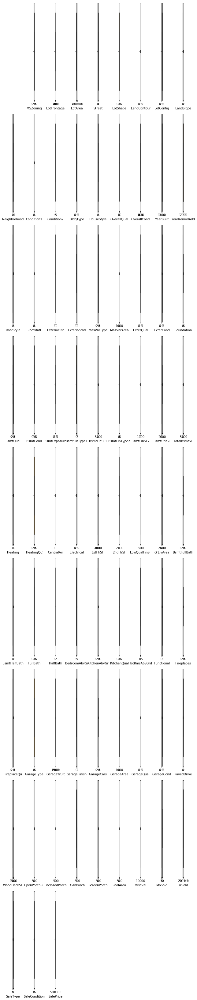

In [110]:
#Visualizing outliers of different variables
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
#Visualizing outliers of different variables
collist=df1.columns.values
ncol=9
nrows=9
plt.figure(figsize=(ncol,5*ncol))
for i in range(1,len(collist)):
    plt.subplot(nrows,ncol,i+1)
    sns.boxplot(df1[collist[i]],color='orange',orient='v')
    plt.tight_layout()

We can see too many outliers present in the dataset. Tried removing outliers but it is giving an information loss of 58.73% which is huge data, hence data removal is not preffered. So instead of removing outliers, data is tranferred using power transfrom and is applied on data to normalize it.

There's no need of separating x and y since we already don't have y variable existing in the test data set. So, we skip the step.


Resolving Skewness using Power Transform

In [111]:
#Using power transform to remove skewness
from sklearn.preprocessing import power_transform
import warnings
warnings.filterwarnings('ignore')
hf1=power_transform(df1,method='yeo-johnson')

hf1=pd.DataFrame(hf1,columns=df1.columns)

In [112]:
#Verifying skewness
hf1.skew()

MSSubClass        0.064007
MSZoning          0.233113
LotFrontage       0.089554
LotArea           0.032509
Street          -17.021969
LotShape         -0.594207
LandContour      -2.592303
LotConfig        -1.030401
LandSlope         3.954345
Neighborhood     -0.146541
Condition1        0.225468
Condition2        0.537277
BldgType          1.857194
HouseStyle       -0.080331
OverallQual       0.021658
OverallCond       0.048063
YearBuilt        -0.126641
YearRemodAdd     -0.225131
RoofStyle        -0.292233
RoofMatl         -6.314987
Exterior1st      -0.338023
Exterior2nd      -0.352793
MasVnrType       -0.016203
MasVnrArea        0.439526
ExterQual        -0.605112
ExterCond        -2.270791
Foundation        0.004296
BsmtQual         -0.413999
BsmtCond         -3.025865
BsmtExposure     -0.914214
BsmtFinType1     -0.206639
BsmtFinSF1       -0.404528
BsmtFinType2     -2.420885
BsmtFinSF2        2.394737
BsmtUnfSF        -0.284390
TotalBsmtSF       0.286779
Heating          -4.541694
H

Skewness in some features can still be seen even after applying transformation methods.

In few variables, even though the skewness is high we cannot clear those variables from the data set because it had good correlation with the target variable in the train data set and few variables have categorical data where we don't consider having outliers or outliers.

Also we cannot drop the columns in the test data set if not deleted in the test data set, other wise we cannot predict the "Sales Price" without having similar variables in both data sets.

Hence, we will proceed with scaling data using Standard Scaler.

# Scaling Data Using Standard Scaler

In [113]:
#Scaling our data to improve model performance
sc=StandardScaler()
x1=sc.fit_transform(hf1)
x1

array([[ 1.37043472, -0.16245555, -0.32706464, ...,  0.40906852,
         0.02973497, -0.67135266],
       [-1.16799937, -0.16245555,  1.19479958, ...,  0.40906852,
         0.02973497,  1.18117384],
       [ 0.4900471 , -0.16245555,  1.08266809, ...,  0.40906852,
         0.02973497,  1.19758737],
       ...,
       [ 1.70079775, -0.16245555, -2.87014809, ...,  0.40906852,
         0.02973497, -0.2940318 ],
       [ 0.69655685, -2.92646435, -0.88298015, ...,  0.40906852,
         0.02973497, -3.71339385],
       [ 0.4900471 , -0.16245555, -0.32706464, ...,  0.40906852,
         0.02973497,  0.23510859]])

# Loading the Best Saved Model

In [114]:
#Loading model
import pickle
fitted_model=pickle.load(open('housing.pkl','rb'))

In [115]:
fitted_model

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=None,
           oob_score=False, random_state=9, verbose=0, warm_start=False)

# Predicting The Test File using the Pre Saved Model

In [116]:
#Making Prediction of "SalesPrice" on test data using algorithm trained on Train data
predictions=fitted_model.predict(x1)

ValueError: Number of features of the model must match the input. Model n_features is 74 and input n_features is 75 

In [117]:
#Prediction of "SalePrice" values on test data 
predictions

NameError: name 'predictions' is not defined

In [118]:
# R2 score of the predicted model
fitted_model=pickle.load(open('housing.pkl','rb'))
result=fitted_model.score(x_test,y_test)
print(result)

0.8756475423772112


Therefore, we are able to predict the test data at 87.56% accuracy.